# Final Project
https://github.com/calanuzao/guitar-pedal

#### Key Components of Effect
- Envelope Filter
- Variable Cutoff Frequency
- Control Variable `Q`: Controls the amount of resonance at the filter's cutoff frequency. Usually 2-10.
- Sensitivity: Gain on envelope
- Min Frequency `start_freq`: Lower bound of the cutoff frequencies
- Max Frequency `stop_freq`: Upper bound of cutoff frequencies
- Filter Type `bandpass`: Filtering type. LPF is more agressive. Bandpass has a smoother transition between frequency bands.
- Mix `Mix`: Think of this as the wet knob. It varies the intensity of the effect by mixing between the filtered and unfiltered signals.
- Fx Gain `fx_gain`: Pre-mix gain
- Input gain `input_gain`: Post mixed gain

In [5]:
# general
import numpy as np

# signal processing
import pywt
from scipy import signal
from scipy.fftpack import fft, ifft

# audio i/o
from IPython.display import Audio 
import soundfile as sf

# plotting
import matplotlib.pyplot as plt

# effect
from utils import WahWah
from pedal import WahPedal
from wavelet import WaveletEffect

In [6]:
# importing audio
audio_file = 'guitar.wav'
audio, fs = sf.read(audio_file)

# play original audio
Audio(audio_file, rate=fs)

# Theory Behind The Wah-Wah Effect

Effect stems from speech processing, and since I am interested in hearing aid acoustics I find this effect a novel way to learn about its implementation.

<div align="center">
    <img src="resources/images/wah-block-diagram.png" alt="Wah-Wah Block Diagram" width="500"/>
    <p><em>Block diagram of the Wah-Wah Effect </em></p>
</div>

"The wah-wah effect gives a voice-like quality to an input signal by simulating the formants found in speech [23]. The first formnt of the [u] vowel is roughly located around 300 Hz, and the first two formants of the [a] vowel are located at apporximately 750 and 1200 Hz. Therefore, the wah-wah simulates the transitions between vowels by adjusting the center frequency of its filter in roughly this range (the exact range depend on the manufacturer and model of pedal, but te range between 400 and 1200 Hz is typical). Wah-wah could be considered a simple form of speech synthesizer, though notclose enough to be truly mistaken for a vowel sound" (Audio Effects: Theory, Implementation and Application pg.106)


### Second Order Resonant Low-Pass Filter:
$$H_{LP, Res}(z)=\frac{^2_c(z^2+2z+1)}{^2_c+_c/G_c+1z^2+2 ^2_c -1z + ^2_c - _c/G_c+1}$$

# Types of Wah's

### Auto-Wah
Manual control of the center frequency (400-1200 Hz). Two variations: in the first the center frequency oscillates back and forth with a LFO and in the second an envelope follower is used to adjust the center frequency according to the amplitude of the input signal.

### Tremolo-Wah
Center frequency controlled by LFO + periodic change in amplitude = tremolo-wah

$$y[n]=w[n]g[n] \; \text{where} \; g[n] = 1 + \alpha \cos(\omega n)$$

$y[n]$ = Output of the entire tremolo-wah
$w[n]$ = Output of the auto-wah section
$g[n]$ = Time varying gain factor
$\omega$ = Normalized angular frequency

### Other Variations
Other variations of the Wah-Wah effect sunoky means ti add additional resonances with a more complex and agressive envelope follower.

#  Implementation
Effect uses second-order IIR Filters. Time complexity can be increased by recalculating  the coefficients less frequently than for each audio sample.

### LFO
The center frequency of the filter over time with sinusoidal LFO and sample rate $f_s$ can be written as
$$f_c[n]=f_{min}+0.5W(1+ \cos(2\pi f_{LFO}n/f_s))$$

### Envelope Follower
Scales the center frequency of the filter proportionally to the level of the input signal. Refer to Digital Envelope Detection: The Good, the Bad, and the Ugly by Richard Lyons.

A 'level detector' must be used in order to calculate a local average value. A common level detector has the following:
- Attack Time $\tau _A$
- Release Time $\tau _R$

$$
y_L[n]=\begin{array}{ll}
\alpha_A y_L[n-1]+\left(1-\alpha_A\right) x_L[n] & x_L[n]>y_L[n-1] \\
\alpha_R y_L[n-1]+\left(1-\alpha_R\right) x_L[n] & x_L[n] \leqslant y_L[n-1]
\end{array}
$$

$$
\alpha_A = e^{-1/(\tau_A fs)}, \quad \alpha_R = e^{-1/(\tau_R fs)}, \quad x_L[n] = \text{Output of the input signal}
$$


The job of an envelope detector is to detect the low frequency amplitude envelope signal from the incoming radio frequency signal. Some parameters include:
- Minimum Frequency
- Sweep Width
- Center Frequency $f_c$ which is a function of the level detector value y_L[n]:$$f_c[n]=f_{min}+Wy_L[n]$$

For this guitar pedal the following synchronous complex envelope detector will be used.

<div align="center">
    <img src="resources/images/envelope-detector.png" alt="Envelope Detector" width="500"/>
    <p><em>Wah-Wah Envelope Detector</em></p>
</div>

Given this synchronous complex envelope detector and assumin an input sample has a value of $A$ and the cosine oscillator's sample is $\cos(\alpha)$. What is the value of the output sample of the square root operation? Assuming the next inpur sample to detector has a value of $-A$ and the cosine oscillator's next sample is $\cos(\beta)$, what is the value of the next ourput sample of the square root operation?

### Analog Emulation
New harmonics and inter-modulation frequency components can be added in the output signal.

In [7]:
# original audio
print("Original Audio:")
audio_file = 'guitar.wav'
audio, fs = sf.read(audio_file)

# convert to mono if stereo
if len(audio.shape) > 1:
    audio = audio[:, 0]  # Take first channel

display(Audio(data=audio, rate=fs))

# auto-wah (envelope follower)
wah_env = WahWah(
    sr=fs,
    min_freq=200.0,
    max_freq=2000.0,
    q=2.0,
    env_cutoff=10.0
)
processed_env = wah_env.process(audio)
print("\nAuto-Wah (Envelope Follower):")
display(Audio(data=processed_env, rate=fs))

# pedal-controlled wah
pedal = WahPedal(pedal_rate=1.0, sr=fs, mode='auto')  # 1 Hz sweep rate
wah_pedal = WahWah(
    sr=fs,
    min_freq=200.0,
    max_freq=2000.0,
    q=8.0,
    env_cutoff=10.0
)
wah_pedal.set_pedal(pedal)
processed_pedal = wah_pedal.process(audio)
print("\nPedal-Controlled Wah:")
display(Audio(data=processed_pedal, rate=fs))

Original Audio:



Auto-Wah (Envelope Follower):



Pedal-Controlled Wah:


# Wavelet-Wah-Wah (WWW) Processing

The wavelet transpose decomposes the signal into different frequency bands that correspons well to the overal taxonomy and spectral composition of the wah-wah effect. Generaly speaking the wah-wah effect's frequency bandwith is similar to speech (300-1200 Hz). Using the wavelet transform the effect can be decomposed by approximately octave bands:

- Level 1: fs/4 to fs/2 Hz
- Level 2: fs/8 to fs/4 Hz
- Level 3: fs/16 to fs/8 Hz
- Level 4: fs/32 to fs/16 Hz
 
For a 44.1kHz signal:
- Level 1: 11025-22050 Hz (too high for wah)
- Level 2: 5512-11025 Hz  (too high for wah)
- Level 3: 2756-5512 Hz   (partial wah range)
- Level 4: 1378-2756 Hz   (main wah range)
- Level 5: 689-1378 Hz    (main wah range)

Modulating the higher levels with a resonant envelope will create a sweep effect characteristic.

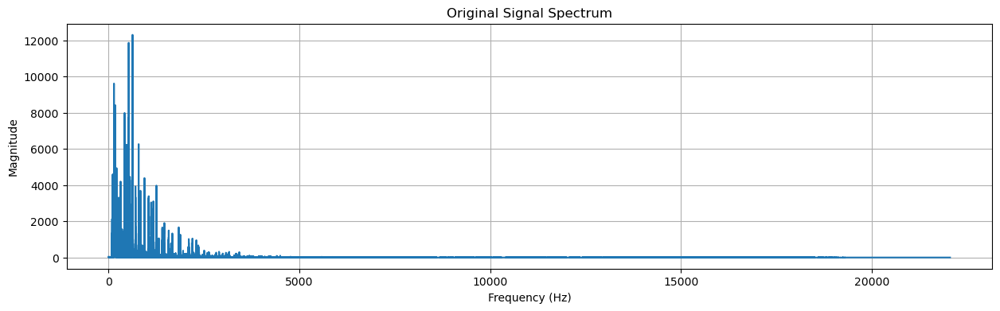

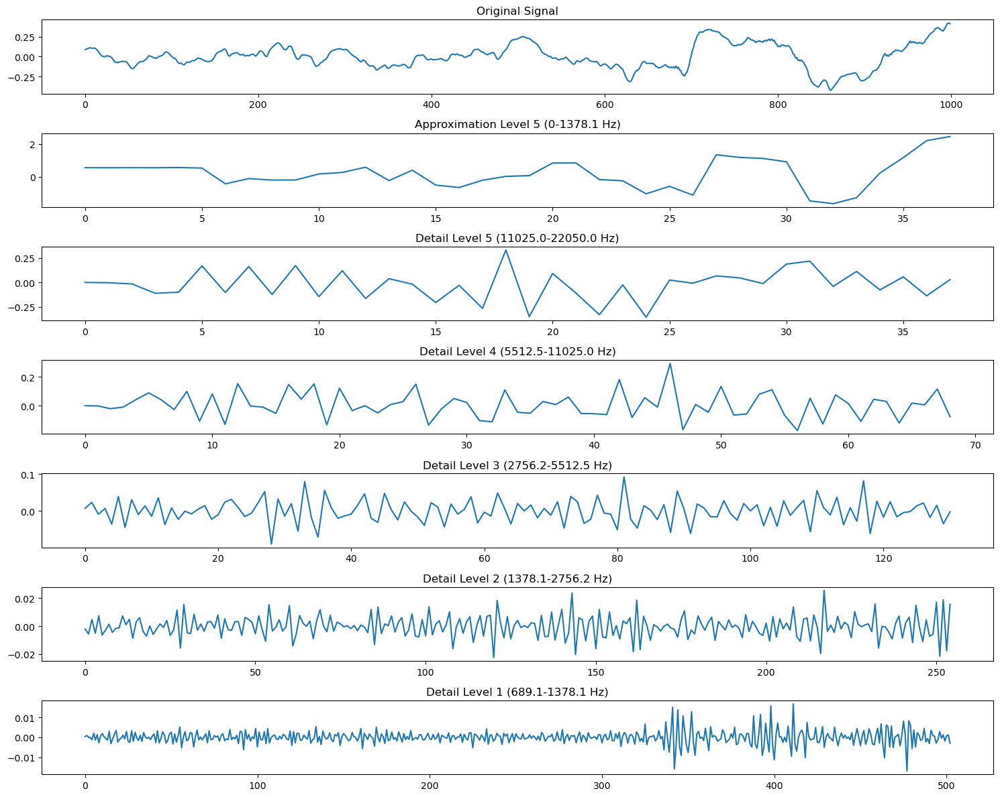

Original Audio:



Wavelet-Processed Audio:


In [8]:
def wavelet_processing(audio, fs, wavelet='db4', level=5):
    coeffs = pywt.wavedec(audio[:1000], wavelet, level=level)  # Use first 1000 samples for visualization
    
    # plot original and decomposed signals
    fig, axes = plt.subplots(level + 2, 1, figsize=(15, 12))
    
    # plot original signal
    axes[0].plot(audio[:1000])
    axes[0].set_title('Original Signal')
    
    # plot approximation coefficients
    axes[1].plot(coeffs[0])
    axes[1].set_title(f'Approximation Level {level} ({0}-{fs/(2**level):.1f} Hz)')
    
    # plot detail coefficients
    for i in range(level):
        axes[i+2].plot(coeffs[i+1])
        freq_range = f'{fs/(2**(i+2)):.1f}-{fs/(2**(i+1)):.1f} Hz'
        axes[i+2].set_title(f'Detail Level {level-i} ({freq_range})')
    
    plt.tight_layout()
    plt.show()

# original signal spectrum
plt.figure(figsize=(15, 4))
freq = np.fft.fftfreq(len(audio), 1/fs)
spectrum = np.abs(np.fft.fft(audio))
plt.plot(freq[:len(freq)//2], spectrum[:len(freq)//2])
plt.title('Original Signal Spectrum')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.grid(True)
plt.show()

# visualize wavelet decomposition
wavelet_processing(audio, fs)

# processing wah-wah effect with wavelet decomposition
wavelet_fx = WaveletEffect(
    wavelet='db4',
    level=5,
    wah_freq_min=300.0,
    wah_freq_max=1200.0,
    resonance=8.0 
)

# comparison
processed_wavelet = wavelet_fx.process(audio)

# mix with original for stronger effect
mix_ratio = 0.7  
final_output = mix_ratio * processed_wavelet + (1 - mix_ratio) * audio

print("Original Audio:")
display(Audio(data=audio, rate=fs))
print("\nWavelet-Processed Audio:")
display(Audio(data=final_output, rate=fs))